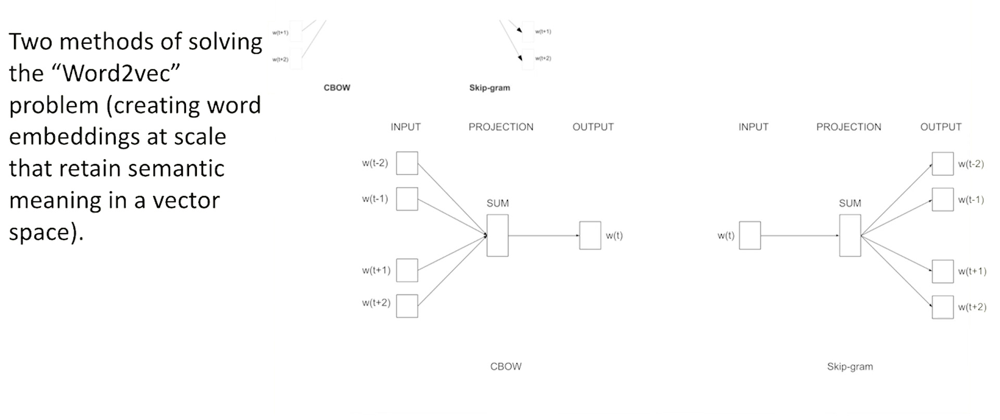


1. **Continuous Bag of Words (CBOW):**
   - CBOW is a model that predicts a target word based on its context.
   - It takes a context of surrounding words (a "bag of words") and tries to predict the target word in the center.
   - The training objective is to maximize the probability of the target word given its context.y
   
   
    Context (Input): "The cat sat on the"
    Target Word (Output): Missing word


2. **Skip-Gram:**
   - Skip-Gram, on the other hand, does the opposite. It predicts the context words (surrounding words) given a target word.
   - The objective is to maximize the probability of the context words given the target word.


    Target Word (Input): "learning"
    Context Words (Output): "Deep," "is"  
   

Learning from large-scale corpora was already causing bias issues.

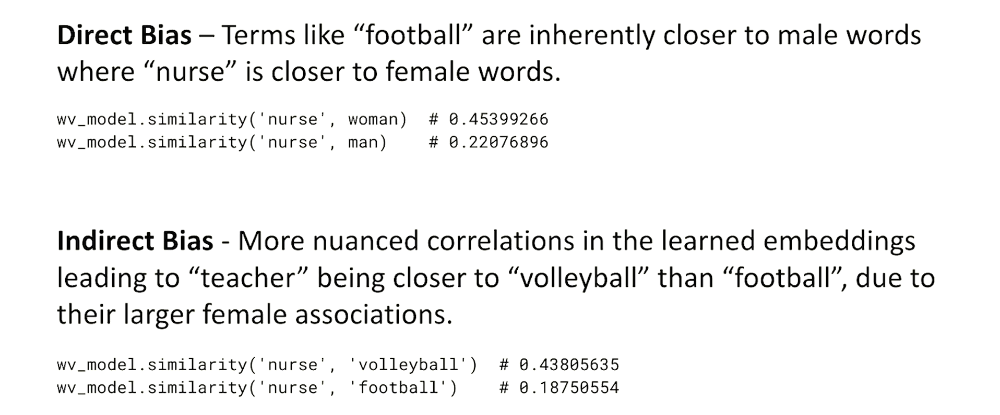

### Language modeling 

In a language modeling task, a model is trained to predict a missing word in a sequence of words. 

In general, there are two types of language models:

* Auto-regressive Models
* Auto-encoding Models

**Auto-regressive Models**

Goal is to predict a future token (word) given either the past tokens or the future tokens but not both.

If you don't ____ (forward prediction)

Output : `mind , want , have, stop`

_____ at the sign, you will get a ticket. (backward prediction)

Output : `Stop , Yield , Slow `

Used in auto-complete, GPT family

**Auto-encoding Models**

Goal is to learn representations of the entire sequence by predicting
tokens given both the past and future tokens.

If you don't _____ at the sign, you will get a ticket.

Output :  If you don't `stop` at the sign, you will get a ticket.

Used in NLU tasks that needs a Comprehensive understanding and encoding of entire sequences of tokens for tasks like Named Entity Recognition, BERT

#### Sequence to sequence models

An encoder reads a variable length input sequence (e.g., English
words) and a decoder produces a variable length sequence
output (e.g., translated French words) using a fixed-length
hidden state from the encoder.

Examples are Recurrent Neural Networks (RNNs) and Long Short-Term Memory networks (LSTMs) 

Both RNNs and LSTMs use recursion to process sequential data. They maintain a hidden state that captures information about the sequence seen so far. This hidden state is updated at each time step and serves as a form of memory that helps the network capture dependencies over time.

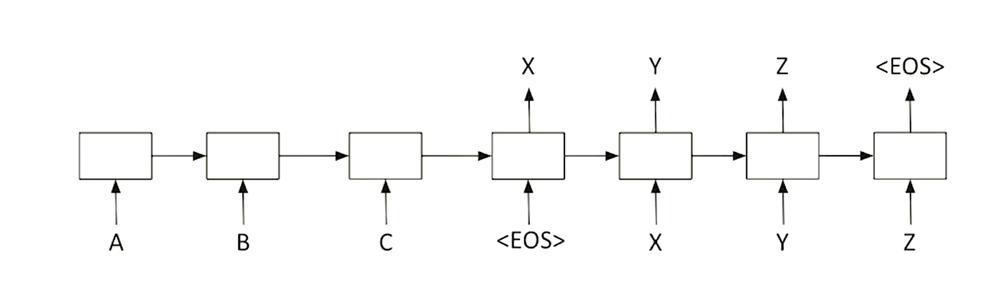

This compressed all the data into fixed length hidden state in the middle. Doing this made it hard to remember long term information


#### Attention

Attention allows the decoder access to the encoder hidden states, which are provided as additional input to the decoder.

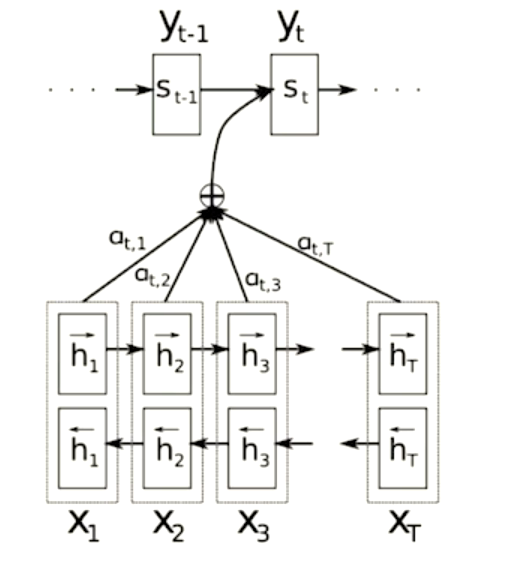

##### Attention exmaples

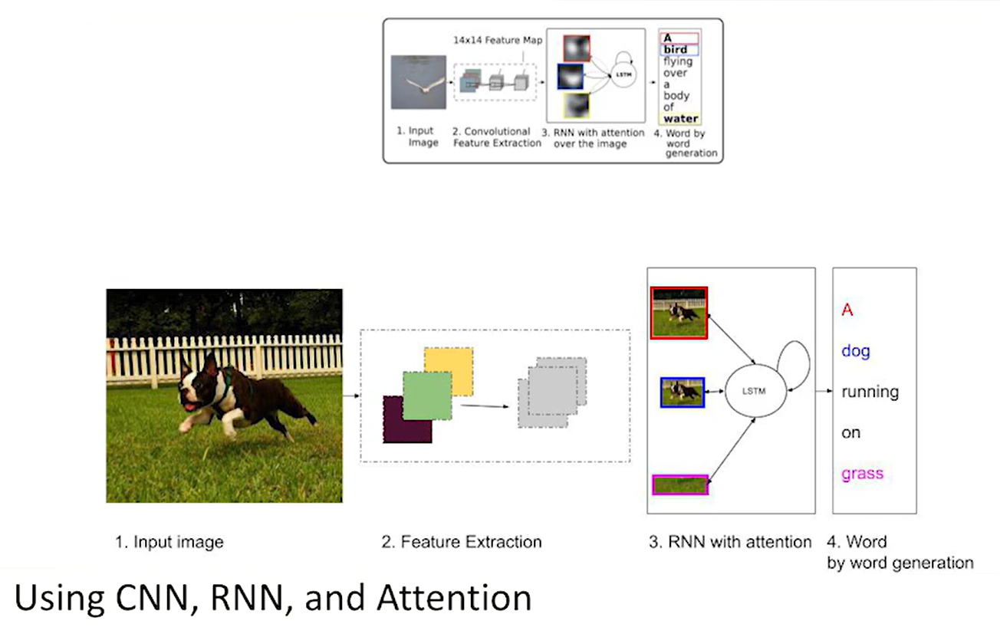

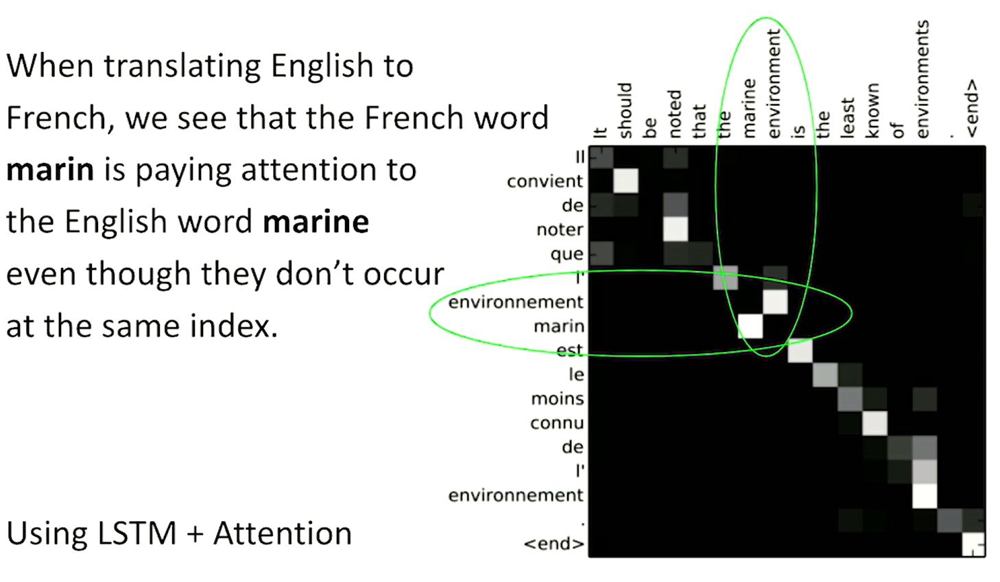

#### Self-Attention

With self-attention, we alter the idea of attention from relating from one sequence to a completly different sequence (like in above image -> caption or english -> french) to "relate each word in the phrase with every other word in the phrase to teach the model the relationships between them".

Consider the phrase : 

My friend told me about this class and I
love it so far! She was right.

    'I" refers to the antecedent "me"
    'She" refers to the antecedent "friend"
    'I" also refers to the fact that I "love" the class
    
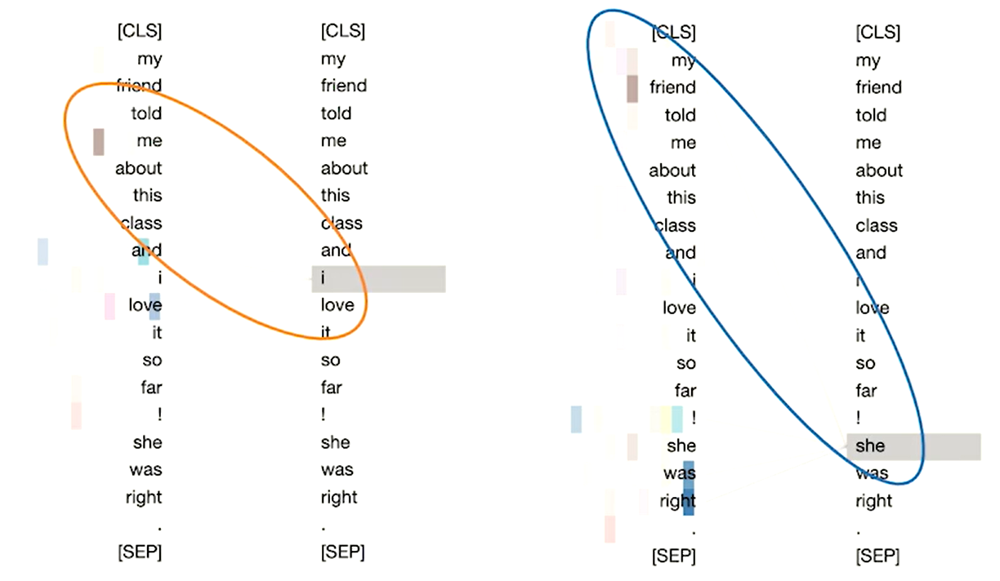    

In [14]:
!pip install bertviz
from transformers import AutoTokenizer
from bertviz.transformers_neuron_view import BertModel
from bertviz.neuron_view import show

from bertviz import head_view
from transformers import AutoModel

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 7.2 MB/s eta 0:00:00
  Obtaining dependency information for botocore<1.30.0,>=1.29.100 from https://files.pythonhosted.org/packages/46/20/e7a9a8e6746872afcc4e3ad5ab503702c38813b3a532df27cce95c98b8cb/botocore-1.29.165-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.0/11.0 MB 77.1 MB/s eta 0:00:00:00:010:01
  Attempting uninstall: botocore
    Found existing installation: botocore 1.33.1
    Uninstalling botocore-1.33.1:
      Successfully uninstalled botocore-1.33.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
aiobotocore 2.8.0 requires botocore<1.33.2,>=1.32.4, but you have botocore 1.29.165 which is incompatible.


In [5]:
model_ckpt = "bert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(model_ckpt)
model = BertModel.from_pretrained(model_ckpt)
text = "My friend told me about this class and I love it so far! She was right."
show(model, "bert", tokenizer, text, display_mode="light", layer=0, head=8)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Transformer

The Transformerrelies almost entirely on self-attention to model the relationship between tokens in a sentence rather than relying on recursion
like RNNs and LSTMs do.

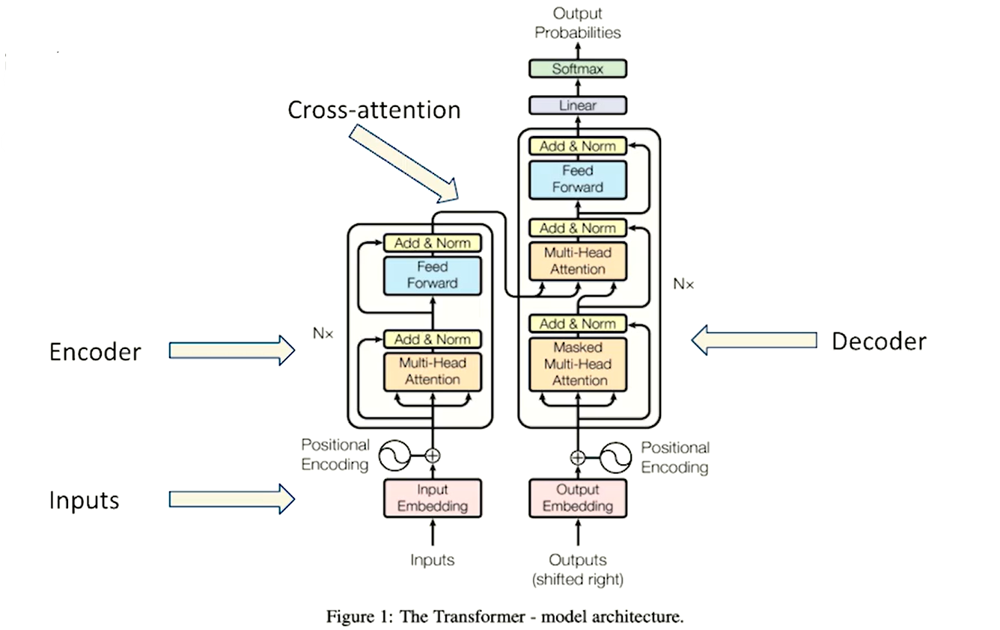

Transformers consists of an encoder and a decoder.

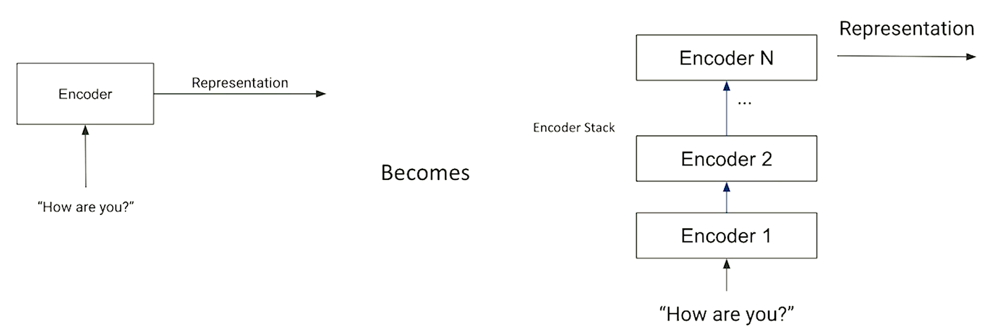

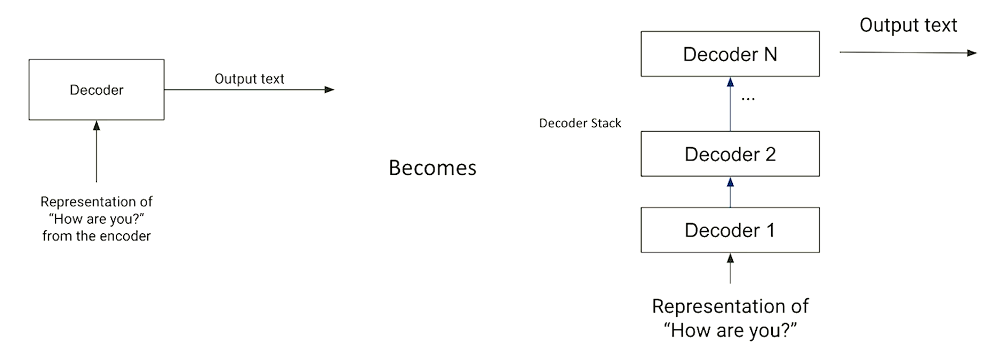



##### Standard attention Calculation

Standard attention is calculated using three matrices called the
`query, key, value` matrices.

Given the input embedding X, Our tokenized input of shpae (number of tokens x token dimension) 

We perform three linear transformations on the matrix X to project it onto
three new vector spaces called the query space, the key space, the value space

query - represent the information we are looking for, it is the information regarding individual tokens as it relates to the overall goal of the sentence, the point of you speaking in the first place

key   - relavance to each word of our query, how imporant each word is with respect to our query

value - context less meaning of input tokens, what each word means on its own (Semantic meaning).

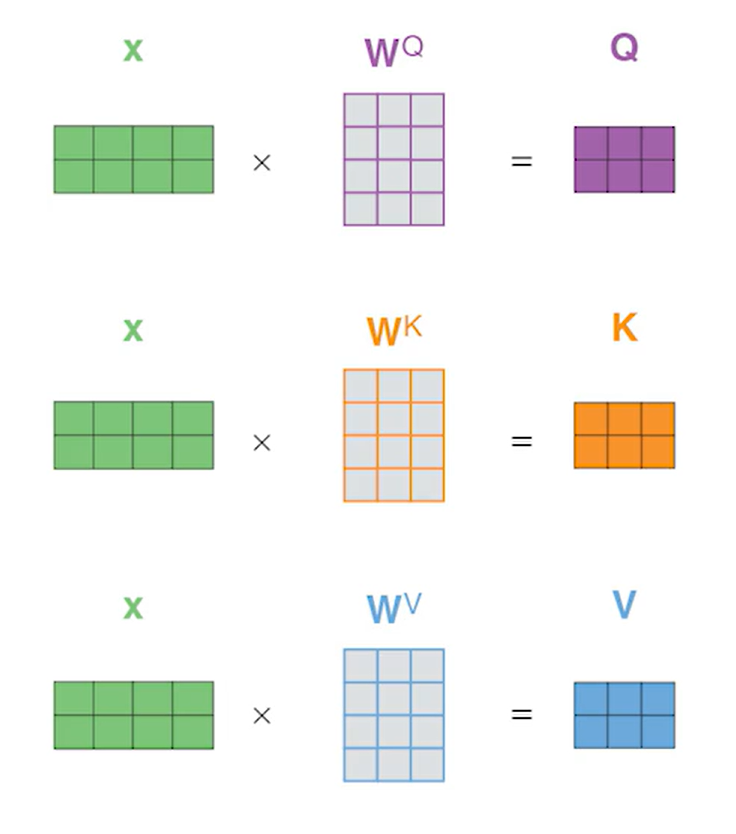


Scaled Dot product

Take the sentenece "I like cats"

1. We are calculating the attention of "like", how much attention "like" should pay to other tokens
Multiply $ \mathbf{Q} \cdot \mathbf{K}^T $

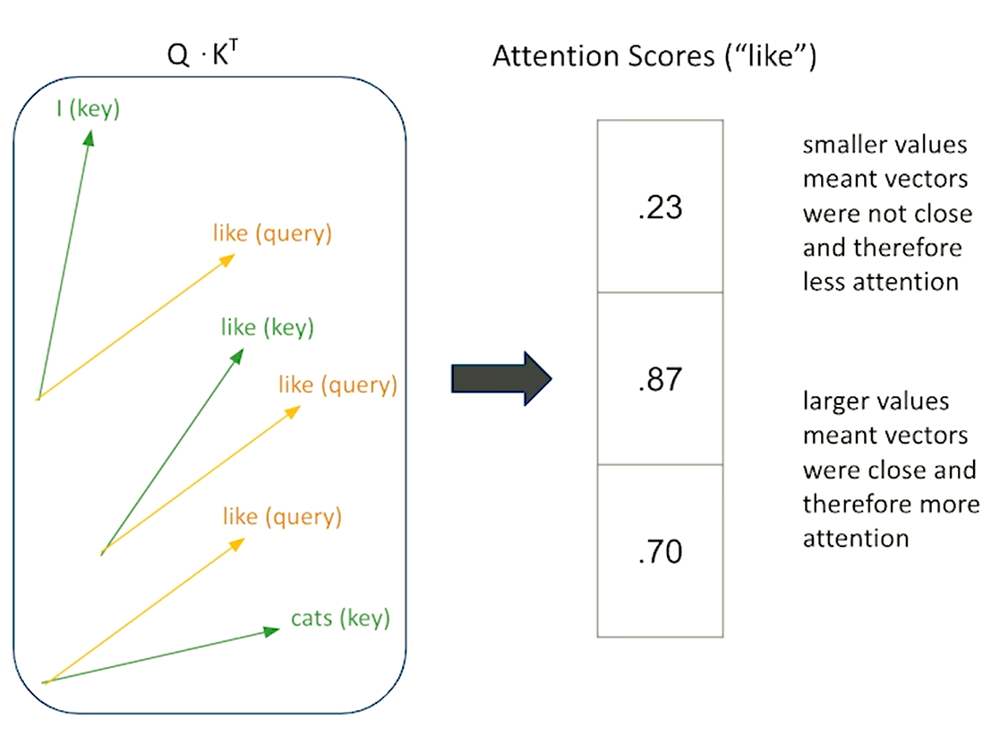

2. Then we apply  

## $ \text{softmax}(\frac{\mathbf{Q} \cdot \mathbf{K}^T}{\sqrt{d_k}}) $

where $ d_k $ is the dimension of vector K 

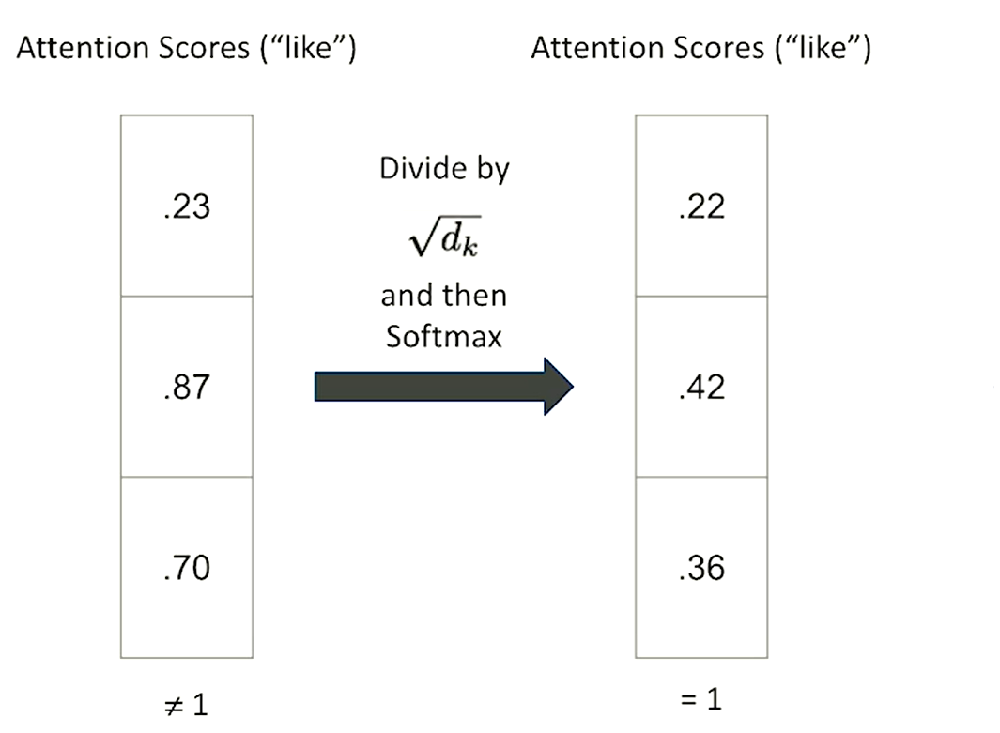

3. Finally multiply by Value maxtrix to get the contextfull embedding/ relavance embedding dimension

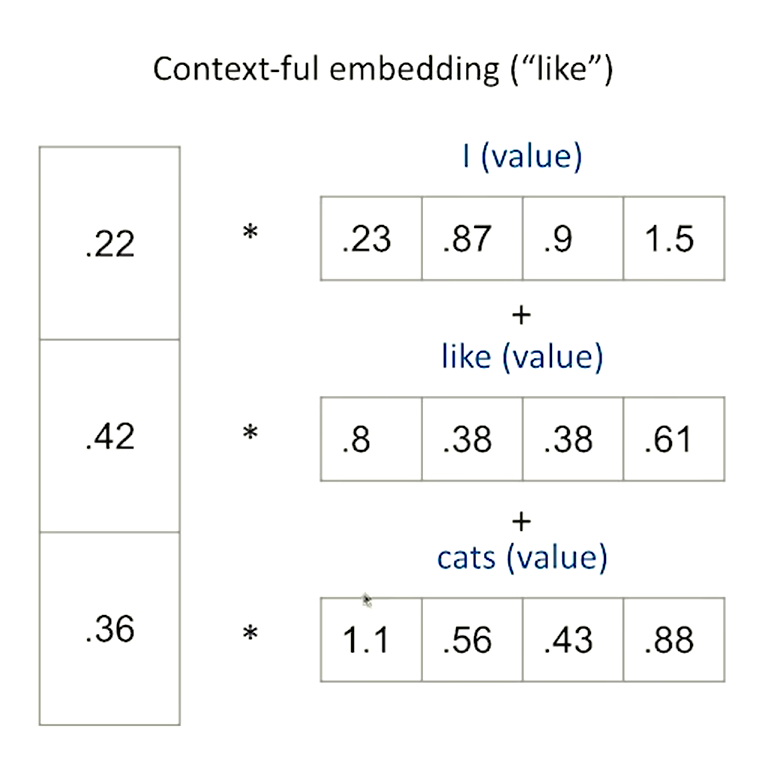

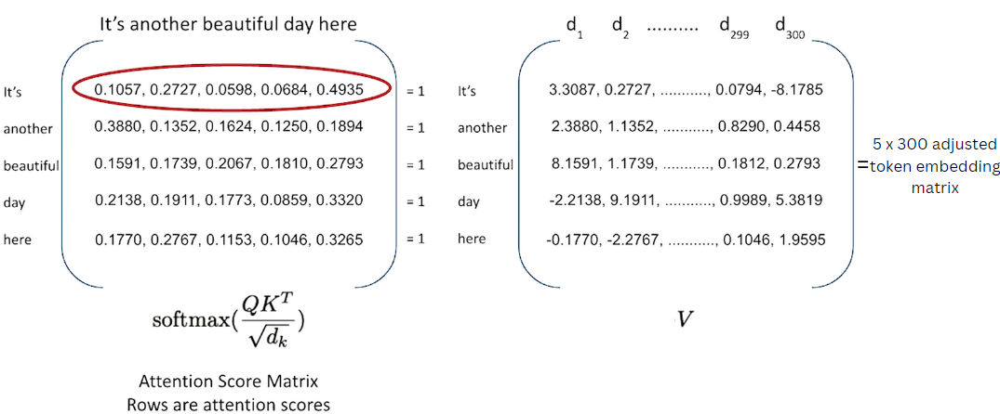                

In [4]:
from transformers import __version__
print(__version__)

from transformers import BertModel

4.35.2


In [6]:
model = BertModel.from_pretrained('bert-base-uncased')

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [8]:
len(model.encoder.layer)

12

In [9]:
# first encoder
model.encoder.layer[0]

BertLayer(
  (attention): BertAttention(
    (self): BertSelfAttention(
      (query): Linear(in_features=768, out_features=768, bias=True)
      (key): Linear(in_features=768, out_features=768, bias=True)
      (value): Linear(in_features=768, out_features=768, bias=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (output): BertSelfOutput(
      (dense): Linear(in_features=768, out_features=768, bias=True)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
  )
  (intermediate): BertIntermediate(
    (dense): Linear(in_features=768, out_features=3072, bias=True)
    (intermediate_act_fn): GELUActivation()
  )
  (output): BertOutput(
    (dense): Linear(in_features=3072, out_features=768, bias=True)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
)

In [10]:
model.encoder.layer[0].attention

BertAttention(
  (self): BertSelfAttention(
    (query): Linear(in_features=768, out_features=768, bias=True)
    (key): Linear(in_features=768, out_features=768, bias=True)
    (value): Linear(in_features=768, out_features=768, bias=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (output): BertSelfOutput(
    (dense): Linear(in_features=768, out_features=768, bias=True)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
)

In [12]:
from transformers import BertConfig
config = BertConfig()
config

BertConfig {
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.35.2",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

### Multi-headed Self-Attention

Transformers + BERT use multi-headed self-attention

That helps to
   
    focus on multiple relationships simultaneously

    learn different types of relations between words
    by transforming our inputs to multiple sub-spaces of Q/K/V

Each encoder has Multiple smaller attention mechanisms (of smaller embedding dimension) concatenated together

Multi-headed self-attention involves using multiple sets of attention weights (heads) in parallel. Each head has its own set of learned parameters and learns different relationships between words.

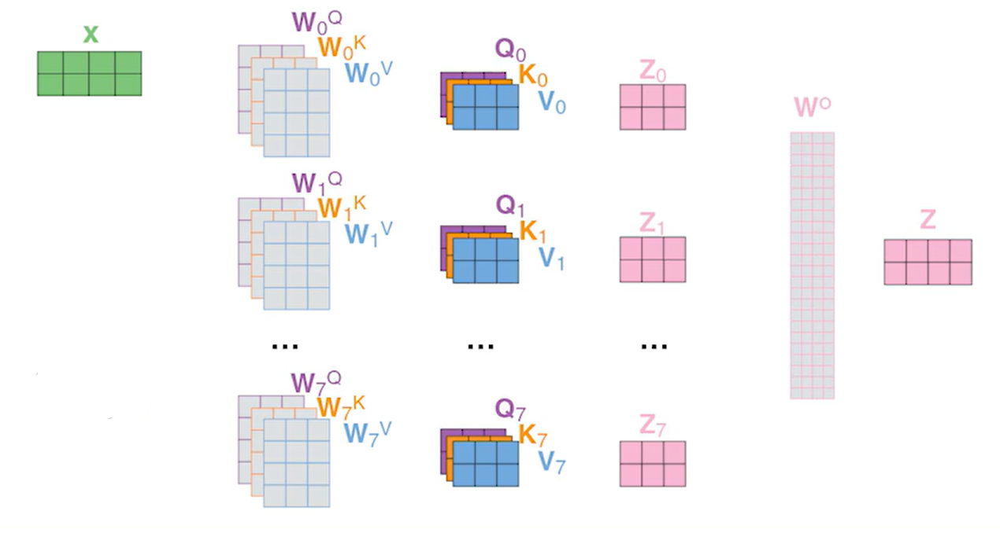

Each attention head processes the `input independently` and produces its own representation of the sequence. This allows the model to capture different types of dependencies and relationships in parallel.

Example shows what Head 8-10 ( 8th encoder's 10th head) learns about objects to verbs like love -> it

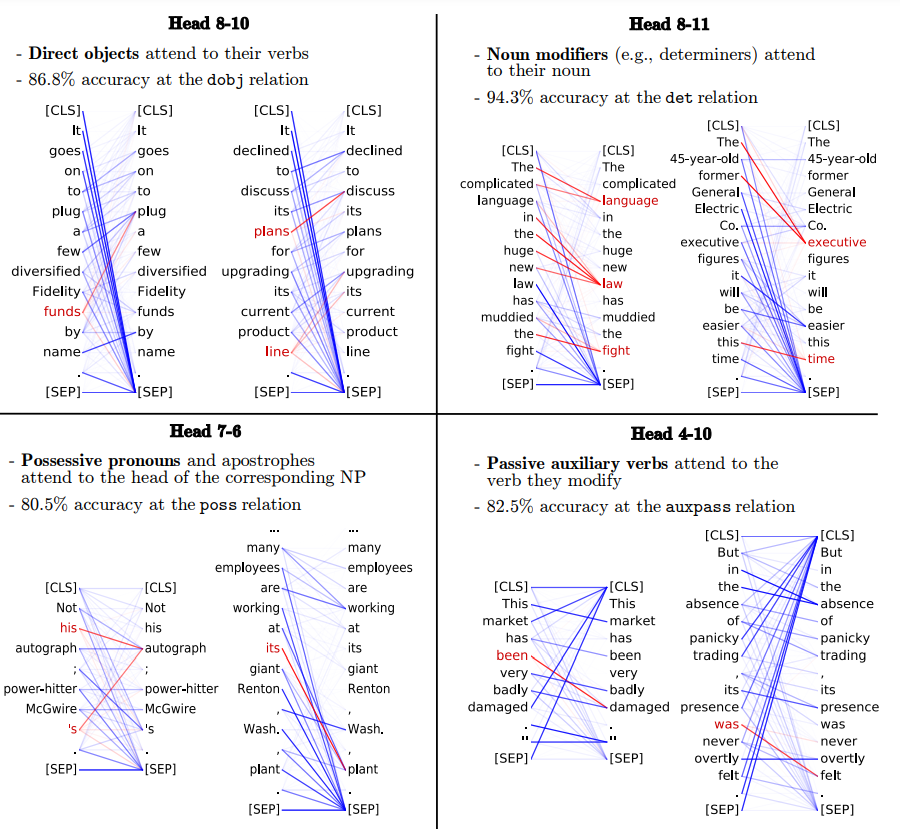
[Link to paper](https://www-nlp.stanford.edu/pubs/clark2019what.pdf)

The outputs of all attention heads are concatenated and linearly transformed to produce the final multi-headed self-attention output.

BERT has 12 attention heads and 12 encoder layers

In [15]:
import torch
import pandas as pd
from transformers import BertModel, BertTokenizer
from bertviz import head_view

In [17]:
# load a vanilla BERT—base model 
model_name = "bert-base-uncased"
tokenizer = BertTokenizer.from_pretrained(model_name)
model = BertModel.from_pretrained(model_name)

tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

In [28]:
text = "My friend told me about this class and I love it so far! She was right."

# 20 tokens total including the CLS and SEP
tokens = tokenizer.encode(text)
inputs = torch.tensor(tokens).unsqueeze(0) # (20,) -> (1,20)
inputs

tensor([[ 101, 2026, 2767, 2409, 2033, 2055, 2023, 2465, 1998, 1045, 2293, 2009,
         2061, 2521,  999, 2016, 2001, 2157, 1012,  102]])

In [29]:
# The attention scores from BERT (12x12)
attention = model(inputs, output_attentions=True)[2]

In [36]:
attention[0].shape

torch.Size([1, 12, 20, 20])

In [40]:
# Get the average attention in the last encoder (12 the encoder) from all the 12 heads
final_attention = attention[-1].mean(1)[0]

In [42]:
final_attention.shape

torch.Size([20, 20])

In [43]:
attention_df = pd.DataFrame(final_attention.detach()).applymap(float).round(3)
attention_df.columns = tokenizer.convert_ids_to_tokens(tokens)
attention_df.index = tokenizer.convert_ids_to_tokens(tokens)

In [45]:
attention_df

,[CLS],my,friend,told,me,about,this,class,and,i,love,it,so,far,!,she,was,right,.,[SEP]
[CLS],0.092,0.028,0.019,0.011,0.012,0.022,0.050,0.087,0.031,0.023,0.023,0.031,0.007,0.028,0.067,0.057,0.065,0.124,0.104,0.120
my,0.021,0.023,0.014,0.010,0.013,0.021,0.028,0.015,0.014,0.012,0.010,0.023,0.011,0.009,0.016,0.022,0.021,0.019,0.312,0.388
friend,0.018,0.009,0.129,0.009,0.005,0.008,0.008,0.012,0.009,0.005,0.009,0.006,0.004,0.005,0.009,0.023,0.010,0.006,0.314,0.401
told,0.010,0.004,0.013,0.084,0.004,0.011,0.005,0.005,0.005,0.002,0.008,0.005,0.005,0.003,0.006,0.008,0.004,0.003,0.351,0.464
me,0.024,0.013,0.010,0.011,0.017,0.016,0.018,0.011,0.014,0.010,0.010,0.014,0.007,0.008,0.014,0.009,0.006,0.005,0.347,0.436
about,0.019,0.010,0.007,0.018,0.010,0.079,0.021,0.012,0.012,0.006,0.014,0.019,0.008,0.008,0.012,0.005,0.003,0.005,0.320,0.412
this,0.026,0.014,0.003,0.004,0.010,0.015,0.069,0.020,0.011,0.010,0.011,0.018,0.006,0.008,0.012,0.005,0.003,0.004,0.331,0.421
class,0.028,0.010,0.007,0.006,0.006,0.015,0.029,0.096,0.010,0.009,0.013,0.019,0.006,0.009,0.015,0.010,0.005,0.005,0.312,0.390
and,0.031,0.016,0.006,0.007,0.012,0.009,0.013,0.009,0.080,0.013,0.010,0.010,0.008,0.009,0.024,0.014,0.012,0.011,0.316,0.386
i,0.023,0.014,0.008,0.005,0.011,0.011,0.019,0.012,0.021,0.029,0.014,0.013,0.008,0.014,0.019,0.012,0.009,0.008,0.334,0.414


In [58]:
tokens_as_list = tokenizer.convert_ids_to_tokens(inputs[0])
head_view(attention,tokens_as_list)

<IPython.core.display.Javascript object>

In [61]:
# Head 3—1 attends to previous token
head_view(attention,tokenizer.convert_ids_to_tokens(inputs[0]),layer=2,heads=[0])

<IPython.core.display.Javascript object>

In [62]:
# Head 8—10 relating direct objects to their verbs eg told —> me

head_view(attention,tokenizer.convert_ids_to_tokens(inputs[0]),layer=7,heads=[9])

<IPython.core.display.Javascript object>

In [63]:
# attention matrix of the 8th encoder's 10th head (Object realation : love -> it, right -> she)

eight_encode_tenth_head = attention[7][0][9]

attention_in_eight_ten_df = pd.DataFrame(eight_encode_tenth_head.detach()).applymap(float).round(3)
attention_in_eight_ten_df.columns = tokenizer.convert_ids_to_tokens(tokens)
attention_in_eight_ten_df.index = tokenizer.convert_ids_to_tokens(tokens)

attention_in_eight_ten_df

,[CLS],my,friend,told,me,about,this,class,and,i,love,it,so,far,!,she,was,right,.,[SEP]
[CLS],0.007,0.004,0.005,0.002,0.001,0.001,0.003,0.004,0.002,0.001,0.002,0.003,0.001,0.005,0.006,0.005,0.010,0.039,0.033,0.867
my,0.031,0.030,0.027,0.009,0.004,0.002,0.001,0.004,0.006,0.001,0.001,0.002,0.001,0.002,0.033,0.002,0.002,0.004,0.050,0.788
friend,0.022,0.128,0.024,0.002,0.002,0.000,0.001,0.001,0.004,0.001,0.001,0.001,0.000,0.002,0.016,0.001,0.002,0.001,0.025,0.765
told,0.035,0.072,0.014,0.013,0.005,0.002,0.002,0.002,0.002,0.000,0.000,0.000,0.000,0.001,0.009,0.001,0.000,0.000,0.034,0.808
me,0.010,0.010,0.005,0.683,0.015,0.007,0.001,0.001,0.001,0.000,0.000,0.000,0.000,0.000,0.003,0.000,0.001,0.003,0.004,0.255
about,0.017,0.015,0.025,0.222,0.024,0.015,0.011,0.020,0.005,0.001,0.001,0.000,0.000,0.001,0.004,0.001,0.001,0.006,0.012,0.618
this,0.005,0.002,0.008,0.223,0.030,0.452,0.073,0.046,0.003,0.001,0.002,0.001,0.001,0.002,0.001,0.000,0.000,0.007,0.001,0.143
class,0.012,0.002,0.004,0.074,0.020,0.204,0.339,0.138,0.004,0.001,0.008,0.007,0.002,0.004,0.001,0.002,0.001,0.018,0.006,0.154
and,0.030,0.008,0.001,0.077,0.019,0.091,0.017,0.013,0.084,0.008,0.002,0.001,0.001,0.001,0.009,0.001,0.002,0.003,0.022,0.610
i,0.022,0.016,0.008,0.181,0.018,0.021,0.003,0.007,0.363,0.033,0.004,0.001,0.002,0.002,0.010,0.000,0.001,0.001,0.004,0.302
